In [30]:
from matplotlib import pyplot as plt
import h5py
import numpy as np
import matplotlib.gridspec as gridspec
import random
from astroML.correlation import two_point
from scipy import spatial
from mpl_toolkits.mplot3d import Axes3D
import plotly.plotly as py
import plotly.graph_objs as go
import plotly.offline as py_offline

cdm = h5py.File('Data/COLOR_CDM_DM_subHaloes_z0.00.hdf5', 'r')
wdm = h5py.File('Data/COLOR_WDM_DM_subHaloes_z0.00.hdf5', 'r')

print(cdm,wdm)

<HDF5 file "COLOR_CDM_DM_subHaloes_z0.00.hdf5" (mode r)> <HDF5 file "COLOR_WDM_DM_subHaloes_z0.00.hdf5" (mode r)>


# Access the masses and positions of CDM and WDM halos

In [4]:
# Access mass/position for wdm/cdm
print(list(cdm.keys()),list(wdm.keys()))

cdm_mass = cdm[list(cdm.keys())[1]][:]
cdm_position = cdm[list(cdm.keys())[2]][:]

wdm_mass = wdm[list(wdm.keys())[1]][:]
wdm_position = wdm[list(cdm.keys())[2]][:]

cdm_mass, cdm_position, wdm_mass, wdm_position

['IsCentral', 'SubhaloMass', 'SubhaloPos'] ['IsCentral', 'SubhaloMass', 'SubhaloPos']


(array([1.87617493e+14, 1.84468594e+14, 6.89978024e+13, ...,
        1.76011232e+08, 1.76011232e+08, 1.76011232e+08]),
 array([[10.93832207, 81.23078918, 54.77935028],
        [17.94562721, 79.86347198, 53.3843956 ],
        [15.62266159, 78.18474579, 52.83857346],
        ...,
        [ 1.47748172,  3.54455233, 99.53264618],
        [99.32190704,  2.56014371,  2.57368279],
        [99.06210327,  4.18381023,  2.89533377]]),
 array([1.89941540e+14, 1.86912732e+14, 6.83256568e+13, ...,
        1.76011232e+08, 1.76011232e+08, 1.76011232e+08]),
 array([[1.80150642e+01, 7.98655701e+01, 5.34328194e+01],
        [1.09048624e+01, 8.12610779e+01, 5.48179665e+01],
        [1.56323376e+01, 7.81665344e+01, 5.28157997e+01],
        ...,
        [6.02296066e+00, 5.05078554e+00, 9.79758224e+01],
        [5.75055540e-01, 3.26677370e+00, 3.52767438e-01],
        [2.07897159e-03, 3.23730016e+00, 9.97708917e-01]]))

### Do the same for central halos

In [5]:
# find the indices of all the central halos
cdm_central = np.where(cdm[list(cdm.keys())[0]][:] == 1)

print(len(cdm_mass[cdm_central]))
print(cdm[list(cdm.keys())[0]][:][cdm_central])

wdm_central = np.where(wdm[list(wdm.keys())[0]][:] == 1)

3961192
[1 1 1 ... 1 1 1]


# Import the mass of a 5 Mpc sphere around each central halo


In [6]:
cdm_5Mpc_sphere_mass = np.genfromtxt("cdm_5Mpc_sphere_mass.txt")
wdm_5Mpc_sphere_mass = np.genfromtxt("wdm_5Mpc_sphere_mass.txt")

In [7]:
cdm_5Mpc_sphere_mass,wdm_5Mpc_sphere_mass

(array([2.93983253e+14, 5.90015914e+14, 3.62308758e+14, ...,
        8.93088892e+12, 1.29342030e+13, 1.31540498e+13]),
 array([3.67286503e+14, 5.83136276e+14, 3.61040039e+14, ...,
        2.98641776e+12, 2.02820383e+12, 2.04709863e+12]))

# Subtract the mass of each central halo from each summed mass

In [8]:
cdm_sphere_mass=cdm_5Mpc_sphere_mass-cdm_mass[cdm_central[0]]
wdm_sphere_mass=wdm_5Mpc_sphere_mass-wdm_mass[wdm_central[0]]

In [9]:
cdm_sphere_mass,wdm_sphere_mass

(array([1.06365761e+14, 2.16812515e+14, 1.24312859e+14, ...,
        8.93071291e+12, 1.29340270e+13, 1.31538738e+13]),
 array([1.77344964e+14, 1.99599119e+14, 1.18699043e+14, ...,
        2.98624175e+12, 2.02802781e+12, 2.04692262e+12]))

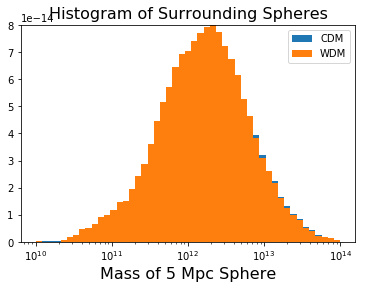

In [10]:
bins=np.logspace(np.log10(1e10),np.log10(1e14), 50)
plt.hist(cdm_sphere_mass, bins=bins,label='CDM',density=True)
plt.hist(wdm_sphere_mass,bins=bins,label='WDM',density=True)
plt.xscale("Log")
plt.xlabel("Mass of 5 Mpc Sphere", fontsize=16)
plt.title("Histogram of Surrounding Spheres", fontsize=16)
plt.legend()
plt.show()

# Plot the positions of the 5 Mpc spheres
### Find the top 10% lowest and highest density regions

In [13]:
#determe the top/bottom 10% of indices
cdm_length=len(cdm_central[0])
wdm_length=len(wdm_central[0])
cdm_ind=int(cdm_length*0.1)
wdm_ind=int(wdm_length*0.1)

#sort the cdm and wdm spheres
cdm_sphere_mass_sorted=np.sort(cdm_sphere_mass)
wdm_sphere_mass_sorted=np.sort(wdm_sphere_mass)

#calculate the low/high density regions for cdm
cdm_top_sphere_mass=cdm_sphere_mass_sorted[cdm_length-cdm_ind:]
cdm_low_sphere_mass=cdm_sphere_mass_sorted[:cdm_ind]

#calculate the low/high density regions for wdm
wdm_top_sphere_mass=wdm_sphere_mass_sorted[wdm_length-wdm_ind:]
wdm_low_sphere_mass=wdm_sphere_mass_sorted[:wdm_ind]

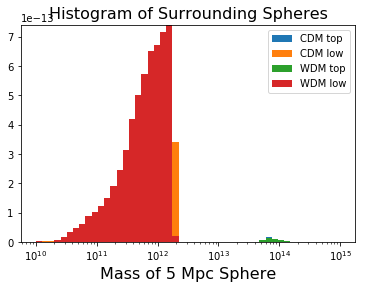

In [14]:
bins=np.logspace(np.log10(1e10),np.log10(1e15), 50)
plt.hist(cdm_top_sphere_mass, bins=bins,label='CDM top',density=True)
plt.hist(cdm_low_sphere_mass,bins=bins,label='CDM low',density=True)
plt.hist(wdm_top_sphere_mass, bins=bins,label='WDM top',density=True)
plt.hist(wdm_low_sphere_mass,bins=bins,label='WDM low',density=True)
plt.xscale("Log")
plt.xlabel("Mass of 5 Mpc Sphere", fontsize=16)
plt.title("Histogram of Surrounding Spheres", fontsize=16)
plt.legend()
plt.show()

# Graph their positions

In [15]:
#get the indices of the low/high density regions
cdm_sphere_mass_sorted_ind=np.argsort(cdm_sphere_mass)
wdm_sphere_mass_sorted_ind=np.argsort(wdm_sphere_mass)

#calculate the low/high density positions for cdm
cdm_top_sphere_position=cdm_position[cdm_sphere_mass_sorted_ind[cdm_length-cdm_ind:]]
cdm_low_sphere_position=cdm_position[cdm_sphere_mass_sorted_ind[:cdm_ind]]

#calculate the low/high density positions for wdm
wdm_top_sphere_position=wdm_position[wdm_sphere_mass_sorted_ind[wdm_length-wdm_ind:]]
wdm_low_sphere_position=wdm_position[wdm_sphere_mass_sorted_ind[:wdm_ind]]

In [16]:
wdm_sphere_mass[wdm_sphere_mass_sorted_ind[wdm_length-wdm_ind:]],wdm_sphere_mass[wdm_sphere_mass_sorted_ind[:wdm_ind]]

(array([5.46509960e+13, 5.46510137e+13, 5.46514430e+13, ...,
        6.56215203e+14, 6.57265137e+14, 6.61916665e+14]),
 array([4.47068517e+09, 4.61149424e+09, 6.80283398e+09, ...,
        1.77091943e+12, 1.77092816e+12, 1.77092821e+12]))

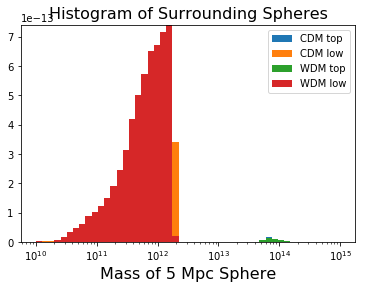

In [18]:
# sanity check: this should look the same as before
bins=np.logspace(np.log10(1e10),np.log10(1e15), 50)
plt.hist(cdm_sphere_mass[cdm_sphere_mass_sorted_ind[cdm_length-cdm_ind:]], 
         bins=bins,label='CDM top',density=True)
plt.hist(cdm_sphere_mass[cdm_sphere_mass_sorted_ind[:cdm_ind]],
         bins=bins,label='CDM low',density=True)
plt.hist(wdm_sphere_mass[wdm_sphere_mass_sorted_ind[wdm_length-wdm_ind:]], 
         bins=bins,label='WDM top',density=True)
plt.hist(wdm_sphere_mass[wdm_sphere_mass_sorted_ind[:wdm_ind]],bins=bins,label='WDM low',density=True)
plt.xscale("Log")
plt.xlabel("Mass of 5 Mpc Sphere", fontsize=16)
plt.title("Histogram of Surrounding Spheres", fontsize=16)
plt.legend()
plt.show()

### 3D Plots

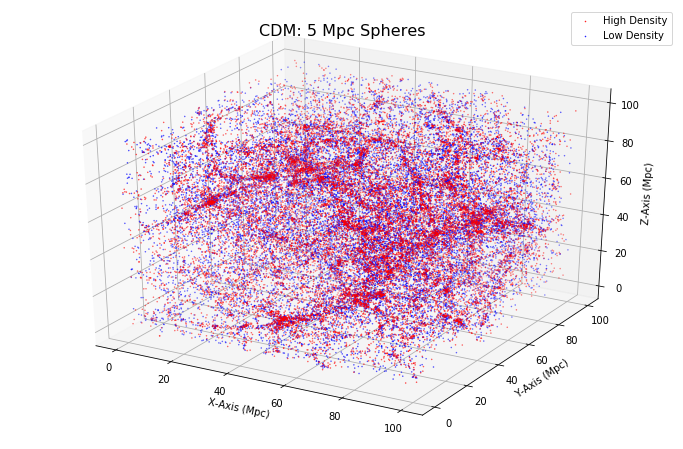

In [43]:
#set decimation factor
d=20

#plot!
fig = plt.figure(figsize = (12,8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(cdm_top_sphere_position[:,0][0::d],
           cdm_top_sphere_position[:,1][0::d],
           cdm_top_sphere_position[:,2][0::d], 
           c='r',s = 0.25,label="High Density")
ax.scatter(cdm_low_sphere_position[:,0][0::d],
           cdm_low_sphere_position[:,1][0::d],
           cdm_low_sphere_position[:,2][0::d], 
           c='b',s = 0.25,label="Low Density")
plt.title("CDM: 5 Mpc Spheres", fontsize=16)
ax.legend()

ax.set_xlabel('X-Axis (Mpc)')
ax.set_ylabel('Y-Axis (Mpc)')
ax.set_zlabel('Z-Axis (Mpc)')

plt.savefig('CDM_Sphere_Position.pdf')
plt.show()

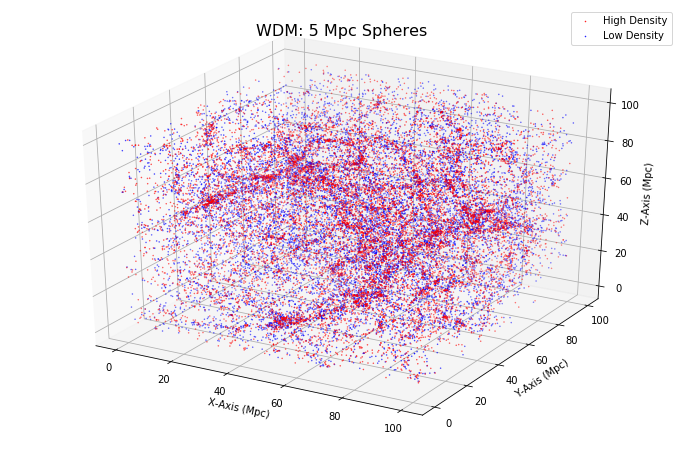

In [162]:
#set decimation factor
d=20

#plot!
fig = plt.figure(figsize = (12,8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(wdm_top_sphere_position[:,0][0::d],
           wdm_top_sphere_position[:,1][0::d],
           wdm_top_sphere_position[:,2][0::d], 
           c='r',s = 0.25,label="High Density")
ax.scatter(wdm_low_sphere_position[:,0][0::d],
           wdm_low_sphere_position[:,1][0::d],
           wdm_low_sphere_position[:,2][0::d], 
           c='b',s = 0.25,label="Low Density")
plt.title("WDM: 5 Mpc Spheres", fontsize=16)
ax.legend()

ax.set_xlabel('X-Axis (Mpc)')
ax.set_ylabel('Y-Axis (Mpc)')
ax.set_zlabel('Z-Axis (Mpc)')

plt.savefig('WDM_Sphere_Position.pdf')
plt.show()

#### Interactive!

In [68]:
#set decimation factor
d=20

trace1=go.Scatter3d(x=cdm_top_sphere_position[:,0][0::d],
           y=cdm_top_sphere_position[:,1][0::d],
           z=cdm_top_sphere_position[:,2][0::d],
           mode='markers', marker=dict(color='red',size=0.5,symbol='circle'),opacity=1)
trace2=go.Scatter3d(x=cdm_low_sphere_position[:,0][0::d],
           y=cdm_low_sphere_position[:,1][0::d],
           z=cdm_low_sphere_position[:,2][0::d],
           mode='markers', marker=dict(color='blue',size=0.5,symbol='circle'),opacity=1)

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))

fig = go.Figure(data=data, layout=layout)

py_offline.init_notebook_mode(connected=True)
py_offline.iplot(fig)

# py.plot(fig, filename='simple-3d-scatter',auto_open=True,fileopt='new',username='mshiferaw')

In [48]:
#set decimation factor
d=20

trace1=go.Scatter3d(x=wdm_top_sphere_position[:,0][0::d],
           y=wdm_top_sphere_position[:,1][0::d],
           z=wdm_top_sphere_position[:,2][0::d],
           mode='markers', marker=dict(color='red',size=0.5,symbol='circle'),opacity=1)
trace2=go.Scatter3d(x=wdm_low_sphere_position[:,0][0::d],
           y=wdm_low_sphere_position[:,1][0::d],
           z=wdm_low_sphere_position[:,2][0::d],
           mode='markers', marker=dict(color='blue',size=0.5,symbol='circle'),opacity=1)

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))

fig = go.Figure(data=data, layout=layout)

py_offline.init_notebook_mode(connected=True)
py_offline.iplot(fig)

### 2D Plots

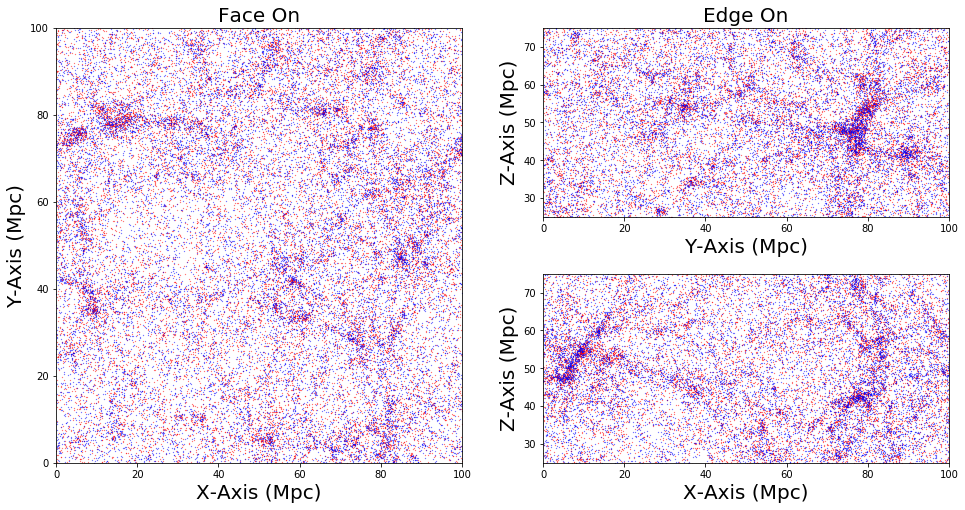

In [168]:
fig = plt.figure(figsize = (16,8))
gs = gridspec.GridSpec(2, 2)

ax1 = fig.add_subplot(gs[:,0])
ax1.scatter(cdm_top_sphere_position[:,0][0::d],
            cdm_top_sphere_position[:,1][0::d], s = 0.05,label="High Density",c='r')
ax1.scatter(cdm_low_sphere_position[:,0][0::d],
            cdm_low_sphere_position[:,1][0::d], s = 0.05,label="Low Density",c='b')
ax1.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax1.set_ylabel('Y-Axis (Mpc)', fontsize = 20)
ax1.set_title('Face On', fontsize = 20)
ax1.set_ylim(0,100)

ax2 = fig.add_subplot(gs[:1,1])
ax2.scatter(cdm_top_sphere_position[:,1][0::d],
            cdm_top_sphere_position[:,2][0::d], s = 0.05,label="High Density",c='r')
ax2.scatter(cdm_low_sphere_position[:,1][0::d],
            cdm_low_sphere_position[:,2][0::d], s = 0.05,label="Low Density",c='b')
ax2.set_xlabel('Y-Axis (Mpc)', fontsize = 20)
ax2.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax2.set_title('Edge On', fontsize = 20)
ax2.set_ylim(25,75)

ax3 = fig.add_subplot(gs[1:,1])
ax3.scatter(cdm_top_sphere_position[:,0][0::d],
            cdm_top_sphere_position[:,2][0::d], s = 0.05,label="High Density",c='r')
ax3.scatter(cdm_low_sphere_position[:,0][0::d],
            cdm_low_sphere_position[:,2][0::d], s = 0.05,label="Low Density",c='b')
ax3.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax3.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax3.set_ylim(25,75)

for axis in [ax1, ax2, ax3]:
    axis.set_xlim(0,100)

gs.update(wspace=0.2, hspace=0.3)
fig.savefig('CDM_2D_Sphere_Mass_Plot.pdf')              
plt.show()

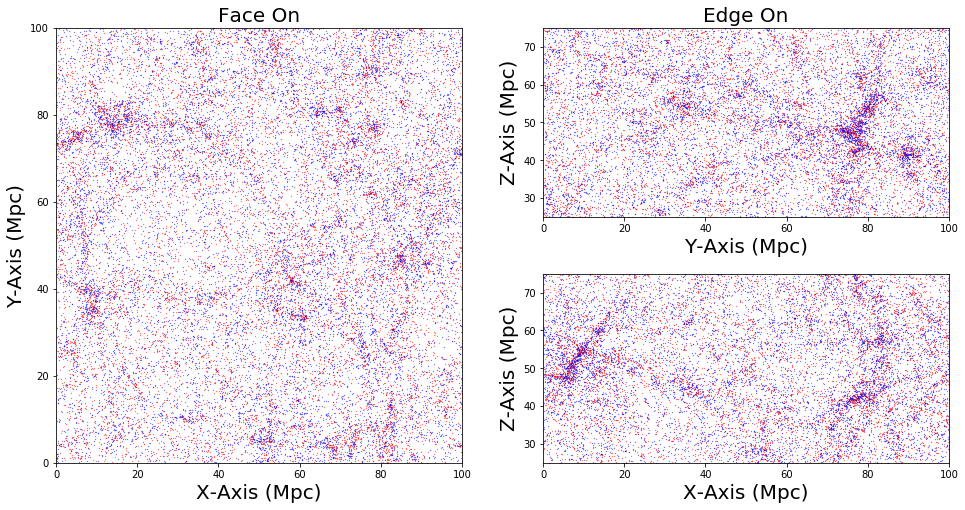

In [169]:
fig = plt.figure(figsize = (16,8))
gs = gridspec.GridSpec(2, 2)

ax1 = fig.add_subplot(gs[:,0])
ax1.scatter(wdm_top_sphere_position[:,0][0::d],
            wdm_top_sphere_position[:,1][0::d], s = 0.05,label="High Density",c='r')
ax1.scatter(wdm_low_sphere_position[:,0][0::d],
            wdm_low_sphere_position[:,1][0::d], s = 0.05,label="Low Density",c='b')
ax1.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax1.set_ylabel('Y-Axis (Mpc)', fontsize = 20)
ax1.set_title('Face On', fontsize = 20)
ax1.set_ylim(0,100)

ax2 = fig.add_subplot(gs[:1,1])
ax2.scatter(wdm_top_sphere_position[:,1][0::d],
            wdm_top_sphere_position[:,2][0::d], s = 0.05,label="High Density",c='r')
ax2.scatter(wdm_low_sphere_position[:,1][0::d],
            wdm_low_sphere_position[:,2][0::d], s = 0.05,label="Low Density",c='b')
ax2.set_xlabel('Y-Axis (Mpc)', fontsize = 20)
ax2.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax2.set_title('Edge On', fontsize = 20)
ax2.set_ylim(25,75)

ax3 = fig.add_subplot(gs[1:,1])
ax3.scatter(wdm_top_sphere_position[:,0][0::d],
            wdm_top_sphere_position[:,2][0::d], s = 0.05,label="High Density",c='r')
ax3.scatter(wdm_low_sphere_position[:,0][0::d],
            wdm_low_sphere_position[:,2][0::d], s = 0.05,label="Low Density",c='b')
ax3.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax3.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax3.set_ylim(25,75)

for axis in [ax1, ax2, ax3]:
    axis.set_xlim(0,100)

gs.update(wspace=0.2, hspace=0.3)
fig.savefig('WDM_2D_Sphere_Mass_Plot.pdf')              
plt.show()

# Repeat for Envelope Mass!
### Import the mass of a 10 Mpc sphere around each central halo


In [50]:
cdm_10Mpc_sphere_mass = np.genfromtxt("cdm_10Mpc_sphere_mass.txt")
wdm_10Mpc_sphere_mass = np.genfromtxt("wdm_10Mpc_sphere_mass.txt")

# Now subtract the mass of a 5 Mpc sphere!


In [51]:
cdm_envelope_mass=cdm_10Mpc_sphere_mass-cdm_5Mpc_sphere_mass
wdm_envelope_mass=wdm_10Mpc_sphere_mass-wdm_5Mpc_sphere_mass

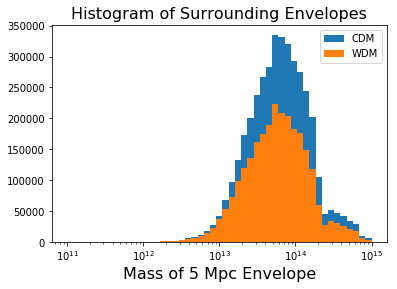

In [52]:
bins=np.logspace(np.log10(1e11),np.log10(1e15), 50)
plt.hist(cdm_envelope_mass, bins=bins,label='CDM')
plt.hist(wdm_envelope_mass,bins=bins,label='WDM')
plt.xscale("Log")
plt.xlabel("Mass of 5 Mpc Envelope", fontsize=16)
plt.title("Histogram of Surrounding Envelopes", fontsize=16)
plt.legend()
plt.show()

# Plot the positions of the 5 Mpc spheres
### Find the top 10% lowest and highest density regions

In [54]:
#sort the cdm and wdm spheres
cdm_envelope_mass_sorted=np.sort(cdm_envelope_mass)
wdm_envelope_mass_sorted=np.sort(wdm_envelope_mass)

#calculate the low/high density regions for cdm
cdm_top_envelope_mass=cdm_envelope_mass_sorted[cdm_length-cdm_ind:]
cdm_low_envelope_mass=cdm_envelope_mass_sorted[:cdm_ind]

#calculate the low/high density regions for wdm
wdm_top_envelope_mass=wdm_envelope_mass_sorted[wdm_length-wdm_ind:]
wdm_low_envelope_mass=wdm_envelope_mass_sorted[:wdm_ind]

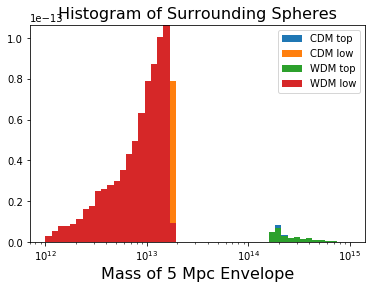

In [55]:
bins=np.logspace(np.log10(1e12),np.log10(1e15), 50)
plt.hist(cdm_top_envelope_mass, bins=bins,label='CDM top',density=True)
plt.hist(cdm_low_envelope_mass,bins=bins,label='CDM low',density=True)
plt.hist(wdm_top_envelope_mass, bins=bins,label='WDM top',density=True)
plt.hist(wdm_low_envelope_mass,bins=bins,label='WDM low',density=True)
plt.xscale("Log")
plt.xlabel("Mass of 5 Mpc Envelope", fontsize=16)
plt.title("Histogram of Surrounding Spheres", fontsize=16)
plt.legend()
plt.show()

# Graph their positions


In [56]:
#get the indices of the low/high density regions
cdm_envelope_mass_sorted_ind=np.argsort(cdm_envelope_mass)
wdm_envelope_mass_sorted_ind=np.argsort(wdm_envelope_mass)

#calculate the low/high density positions for cdm
cdm_top_envelope_position=cdm_position[cdm_envelope_mass_sorted_ind[cdm_length-cdm_ind:]]
cdm_low_envelope_position=cdm_position[cdm_envelope_mass_sorted_ind[:cdm_ind]]

#calculate the low/high density positions for wdm
wdm_top_envelope_position=wdm_position[wdm_envelope_mass_sorted_ind[wdm_length-wdm_ind:]]
wdm_low_envelope_position=wdm_position[wdm_envelope_mass_sorted_ind[:wdm_ind]]

### 3D Plots

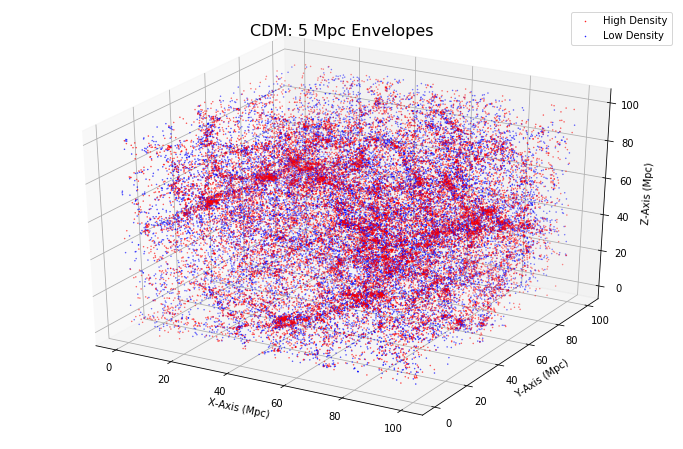

In [165]:
#set decimation factor
d=20

#plot!
fig = plt.figure(figsize = (12,8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(cdm_top_envelope_position[:,0][0::d],
           cdm_top_envelope_position[:,1][0::d],
           cdm_top_envelope_position[:,2][0::d], 
           c='r',s = 0.25,label="High Density")
ax.scatter(cdm_low_envelope_position[:,0][0::d],
           cdm_low_envelope_position[:,1][0::d],
           cdm_low_envelope_position[:,2][0::d], 
           c='b',s = 0.25,label="Low Density")
plt.title("CDM: 5 Mpc Envelopes", fontsize=16)
ax.legend()

ax.set_xlabel('X-Axis (Mpc)')
ax.set_ylabel('Y-Axis (Mpc)')
ax.set_zlabel('Z-Axis (Mpc)')

plt.savefig('CDM_Envelope_Position.pdf')
plt.show()

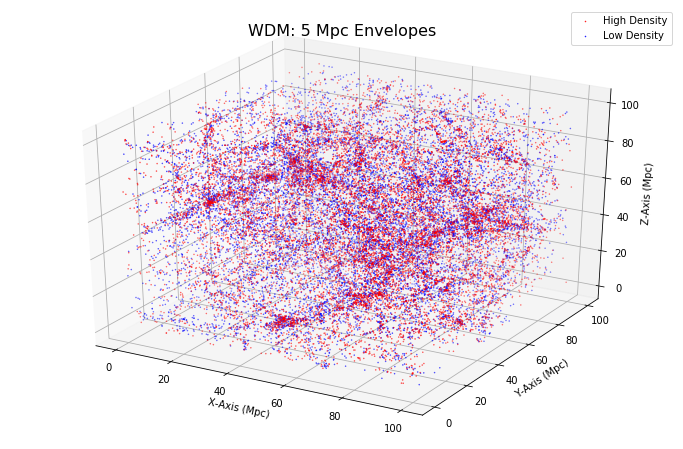

In [166]:
#set decimation factor
d=20

#plot!
fig = plt.figure(figsize = (12,8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(wdm_top_envelope_position[:,0][0::d],
           wdm_top_envelope_position[:,1][0::d],
           wdm_top_envelope_position[:,2][0::d], 
           c='r',s = 0.25,label="High Density")
ax.scatter(wdm_low_envelope_position[:,0][0::d],
           wdm_low_envelope_position[:,1][0::d],
           wdm_low_envelope_position[:,2][0::d], 
           c='b',s = 0.25,label="Low Density")
plt.title("WDM: 5 Mpc Envelopes", fontsize=16)
ax.legend()

ax.set_xlabel('X-Axis (Mpc)')
ax.set_ylabel('Y-Axis (Mpc)')
ax.set_zlabel('Z-Axis (Mpc)')

plt.savefig('WDM_Envelope_Position.pdf')
plt.show()

#### Interactive!

In [57]:
#set decimation factor
d=20

trace1=go.Scatter3d(x=cdm_top_envelope_position[:,0][0::d],
           y=cdm_top_envelope_position[:,1][0::d],
           z=cdm_top_envelope_position[:,2][0::d],
           mode='markers', marker=dict(color='red',size=0.5,symbol='circle'),opacity=1)
trace2=go.Scatter3d(x=cdm_low_envelope_position[:,0][0::d],
           y=cdm_low_envelope_position[:,1][0::d],
           z=cdm_low_envelope_position[:,2][0::d],
           mode='markers', marker=dict(color='blue',size=0.5,symbol='circle'),opacity=1)

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))

fig = go.Figure(data=data, layout=layout)

py_offline.init_notebook_mode(connected=True)
py_offline.iplot(fig)

In [58]:
#set decimation factor
d=20

trace1=go.Scatter3d(x=wdm_top_envelope_position[:,0][0::d],
           y=wdm_top_envelope_position[:,1][0::d],
           z=wdm_top_envelope_position[:,2][0::d],
           mode='markers', marker=dict(color='red',size=0.5,symbol='circle'),opacity=1)
trace2=go.Scatter3d(x=wdm_low_envelope_position[:,0][0::d],
           y=wdm_low_envelope_position[:,1][0::d],
           z=wdm_low_envelope_position[:,2][0::d],
           mode='markers', marker=dict(color='blue',size=0.5,symbol='circle'),opacity=1)

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))

fig = go.Figure(data=data, layout=layout)

py_offline.init_notebook_mode(connected=True)
py_offline.iplot(fig)

### 2D Plots

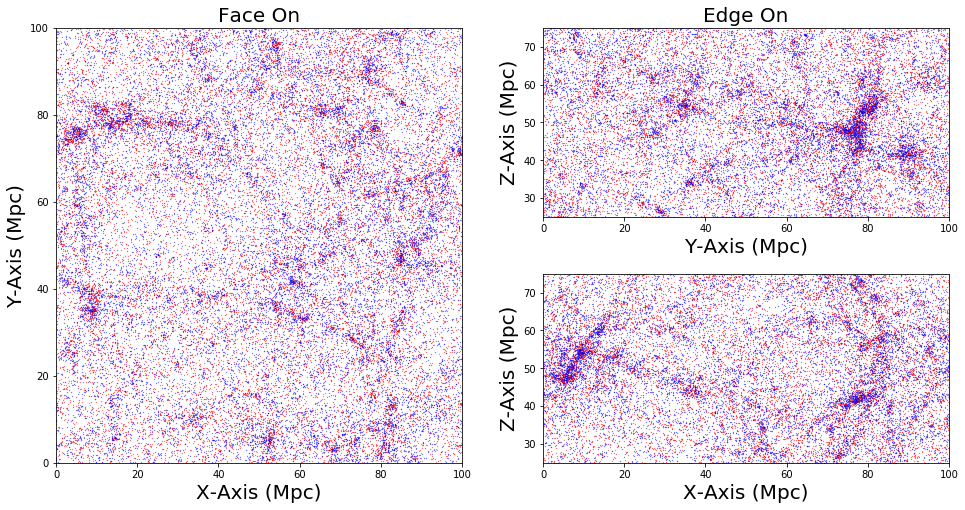

In [170]:
fig = plt.figure(figsize = (16,8))
gs = gridspec.GridSpec(2, 2)

ax1 = fig.add_subplot(gs[:,0])
ax1.scatter(cdm_top_envelope_position[:,0][0::d],
            cdm_top_envelope_position[:,1][0::d], s = 0.05,label="High Density",c='r')
ax1.scatter(cdm_low_envelope_position[:,0][0::d],
            cdm_low_envelope_position[:,1][0::d], s = 0.05,label="Low Density",c='b')
ax1.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax1.set_ylabel('Y-Axis (Mpc)', fontsize = 20)
ax1.set_title('Face On', fontsize = 20)
ax1.set_ylim(0,100)

ax2 = fig.add_subplot(gs[:1,1])
ax2.scatter(cdm_top_envelope_position[:,1][0::d],
            cdm_top_envelope_position[:,2][0::d], s = 0.05,label="High Density",c='r')
ax2.scatter(cdm_low_envelope_position[:,1][0::d],
            cdm_low_envelope_position[:,2][0::d], s = 0.05,label="Low Density",c='b')
ax2.set_xlabel('Y-Axis (Mpc)', fontsize = 20)
ax2.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax2.set_title('Edge On', fontsize = 20)
ax2.set_ylim(25,75)

ax3 = fig.add_subplot(gs[1:,1])
ax3.scatter(cdm_top_envelope_position[:,0][0::d],
            cdm_top_envelope_position[:,2][0::d], s = 0.05,label="High Density",c='r')
ax3.scatter(cdm_low_envelope_position[:,0][0::d],
            cdm_low_envelope_position[:,2][0::d], s = 0.05,label="Low Density",c='b')
ax3.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax3.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax3.set_ylim(25,75)

for axis in [ax1, ax2, ax3]:
    axis.set_xlim(0,100)

gs.update(wspace=0.2, hspace=0.3)
fig.savefig('CDM_2D_Envelope_Mass_Plot.pdf')              
plt.show()

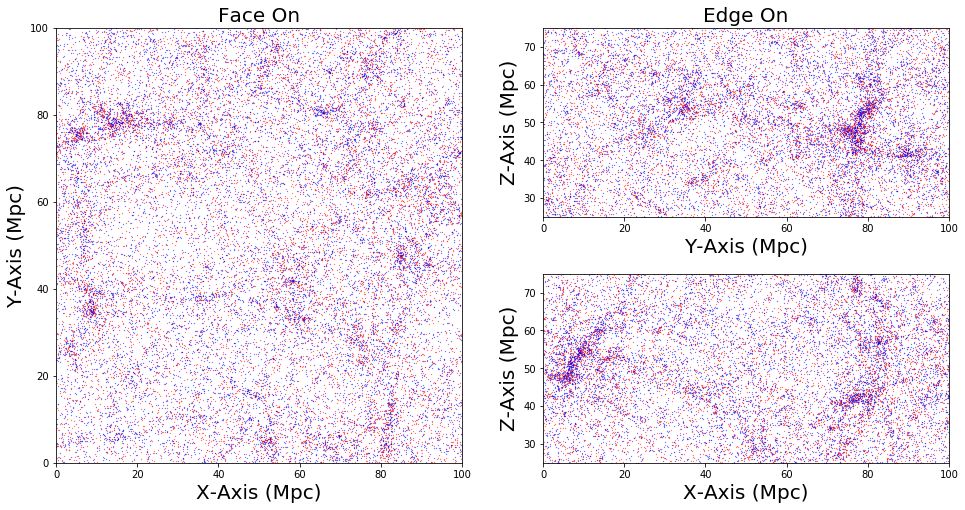

In [171]:
fig = plt.figure(figsize = (16,8))
gs = gridspec.GridSpec(2, 2)

ax1 = fig.add_subplot(gs[:,0])
ax1.scatter(wdm_top_envelope_position[:,0][0::d],
            wdm_top_envelope_position[:,1][0::d], s = 0.05,label="High Density",c='r')
ax1.scatter(wdm_low_envelope_position[:,0][0::d],
            wdm_low_envelope_position[:,1][0::d], s = 0.05,label="Low Density",c='b')
ax1.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax1.set_ylabel('Y-Axis (Mpc)', fontsize = 20)
ax1.set_title('Face On', fontsize = 20)
ax1.set_ylim(0,100)

ax2 = fig.add_subplot(gs[:1,1])
ax2.scatter(wdm_top_envelope_position[:,1][0::d],
            wdm_top_envelope_position[:,2][0::d], s = 0.05,label="High Density",c='r')
ax2.scatter(wdm_low_envelope_position[:,1][0::d],
            wdm_low_envelope_position[:,2][0::d], s = 0.05,label="Low Density",c='b')
ax2.set_xlabel('Y-Axis (Mpc)', fontsize = 20)
ax2.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax2.set_title('Edge On', fontsize = 20)
ax2.set_ylim(25,75)

ax3 = fig.add_subplot(gs[1:,1])
ax3.scatter(wdm_top_envelope_position[:,0][0::d],
            wdm_top_envelope_position[:,2][0::d], s = 0.05,label="High Density",c='r')
ax3.scatter(wdm_low_envelope_position[:,0][0::d],
            wdm_low_envelope_position[:,2][0::d], s = 0.05,label="Low Density",c='b')
ax3.set_xlabel('X-Axis (Mpc)', fontsize = 20)
ax3.set_ylabel('Z-Axis (Mpc)', fontsize = 20)
ax3.set_ylim(25,75)

for axis in [ax1, ax2, ax3]:
    axis.set_xlim(0,100)

gs.update(wspace=0.2, hspace=0.3)
fig.savefig('WDM_2D_Envelope_Mass_Plot.pdf')              
plt.show()

Next time: associate galaxies with halos by matching nearest positions to halos. (ie the position of each central galaxy corresponds with the center of a central halo. find the corresponding central galaxies --> halos. then use virial radius to expand outwards and find all the corresponding galaxies within that radius)

try looping over just central halos > m_res
or do it after the fact using the correct indices!

2D plots: try just doing a 10 Mpc width to avoid line of sight effects